# 2021-09-27

In [1]:
import os 
import glob
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial import distance
from sklearn.preprocessing import MinMaxScaler

In [ ]:
# ## Task: 
# 1. R-R interval 나누기
# 2. R-R amplitude Normalization
# 3. R-R time frame(data points) Normalization 

# - 일단 3번까지 완료하기
# 4. R-R referecne frame 잡기 -> median값으로 (어떤 median?)


# # ref. 기준점 max R = 1 
# # cycle을 뽑아내서 

# resampling 
# reference frame -> median 
# cosine similarity: 가장 작은 데이터 보기

In [2]:
# load data
PATH_IN = r'C:\Users\MI2RL-KHJ\workspace_signal\mit\processed_arr'
os.chdir(PATH_IN)
rpeakList = [i for i in os.listdir(PATH_IN) if i.startswith('correct')]
fxvalList = [i for i in os.listdir(PATH_IN) if i.startswith('filtered')]

In [3]:
# check sample 
rpeaks = pd.read_csv(rpeakList[0], header=None)
fxvalList = pd.read_csv(fxvalList[0], header=None)

In [4]:
# Task: 2. R-R amplitude Normalization

# min-max normalization 
min_max_scaler = MinMaxScaler()
fxvals = fxvalList

# minmax normalization for fxvals(ECG Voltage)
fxvals_MinMax = min_max_scaler.fit_transform(fxvals)

# examples
fxvals_MinMax[370], fxvals_MinMax[662], fxvals_MinMax[947]

(array([0.78493163]), array([0.78982738]), array([0.77506309]))

(array([0.78982738]), array([0.35939236]))

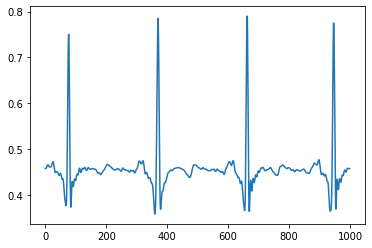

In [12]:
# plt.plot(fxvals[0:1000])
#max(fxvals[0:1000]), min(fxvals[0:1000])
plt.plot(fxvals_MinMax[0:1000])
max(fxvals_MinMax[0:1000]), min(fxvals_MinMax[0:1000])


In [5]:
rr_peaks = []
for i in range(len(rpeaks)):
    rpeak_point = int(rpeaks.loc[i][0])
    rr_peaks.append(rpeak_point)

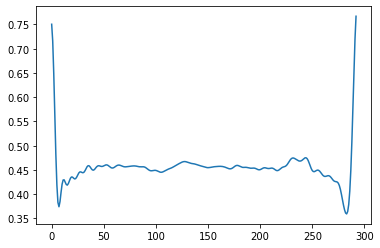

In [6]:
# max(fxvals_MinMax[0:1000]), min(fxvals_MinMax[0:1000])
# y-axis = fxvals_MinMax (EKG amplitude)
# x-axis = rr_intervals(datapoint)
plt.plot(fxvals_MinMax[rr_peaks[0]:rr_peaks[1]])

(array([1.000e+01, 1.800e+01, 3.100e+01, 3.790e+02, 1.452e+03, 3.510e+02,
        1.300e+01, 1.600e+01, 0.000e+00, 1.000e+00]),
 array([179. , 203.2, 227.4, 251.6, 275.8, 300. , 324.2, 348.4, 372.6,
        396.8, 421. ]),
 <BarContainer object of 10 artists>)

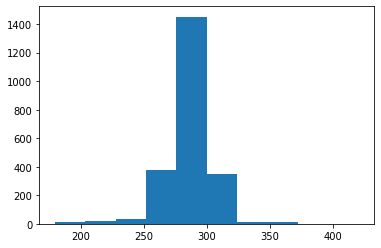

In [7]:
# Task: 1. R-R interval 나누기 + 3. R-R time frame(data points) Normalization 

# rr-interval
rr_intervals = []
for i in range(len(rpeaks)):
    if i + 1 == len(rpeaks):
        break
    else:
        rr_interval = rpeaks.iloc[i+1] - rpeaks.iloc[i]
        rr_intervals.append(int(rr_interval))

        
plt.hist(rr_intervals)# np.mean(rr_intervals), np.median(rr_intervals), np.max(rr_intervals)

In [8]:
# Task: 3. R-R time frame(data points) Normalization 

display(pd.DataFrame(rr_intervals).describe())
display(np.median(rr_intervals))

,0
count,2271.000000
mean,286.066050
std,17.663149
min,179.000000
25%,278.000000
50%,287.000000
75%,296.000000
max,421.000000


287.0

In [9]:
# Task: 3. R-R time frame(data points) Normalization 
# rr_interval, yvals

rr_intervals = []
y_vals = []
for i in range(len(rpeaks)):
    if i + 1 == len(rpeaks):
        break
    else:
        rr_interval = rpeaks.iloc[i+1] - rpeaks.iloc[i]
        y_val = fxvals_MinMax[int(rpeaks.iloc[i]):int(rpeaks.iloc[i+1])]
        rr_intervals.append(int(rr_interval))
        y_vals.append(y_val)
        
len(y_vals), len(rr_intervals)

(2271, 2271)

In [11]:
# Task: 3. R-R time frame(data points) Normalization 
# Test: check for resampling

from scipy import signal
# x =  list(range(rr_intervals[0]))
y = y_vals[0]
f = signal.resample(y_vals[0], int(np.median(rr_intervals)))

len(f), len(y_vals[0])

(287, 293)

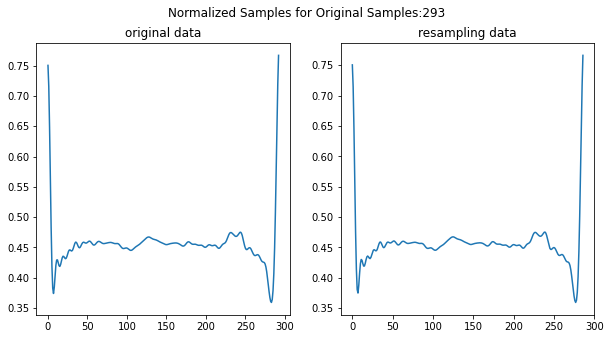

(293, 287)

In [12]:
# compare resampling data with original data

import numpy as np
import matplotlib.pyplot as plt


plt.figure(figsize=(10, 5))
plt.suptitle('Normalized Samples for Original Samples:{}'.format(len(y_vals[0])))

plt.subplot(121)
plt.plot(y_vals[0])
plt.title('original data')
 
plt.subplot(122)
plt.plot(f)
plt.title('resampling data')
plt.show()

len(y_vals[0]), len(f)

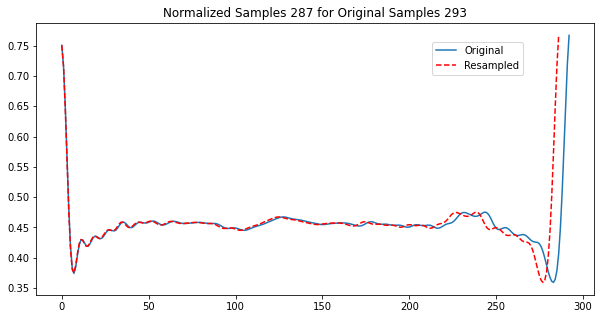

In [13]:
plt.figure(figsize=(10, 5))
plt.title('Normalized Samples {} for Original Samples {}'.format(len(f),len(y_vals[0])))
plt.plot(y_vals[0], label='Original')
plt.plot(f, 'r--', label='Resampled')
plt.legend(loc='upper left', bbox_to_anchor=(0.7, 0.95))

## Resampling based on RR-intervals' median

In [15]:
# Already porcessed
# # Split samples based on rr_intervals 
# rr_intervals = []
# y_vals = []
# for i in range(len(rpeaks)):
#     if i + 1 == len(rpeaks):
#         break
#     else:
#         rr_interval = rpeaks.iloc[i+1] - rpeaks.iloc[i]
#         y_val = fxvals_MinMax[int(rpeaks.iloc[i]):int(rpeaks.iloc[i+1])]
#         rr_intervals.append(int(rr_interval))
#         y_vals.append(y_val)

# resampling
from scipy import signal
new_yvals = []
norm_sample= int(np.median(rr_intervals))
for i in range(len(y_vals)):
    new_yval = signal.resample(y_vals[i], norm_sample)
    new_yvals.append(new_yval)

In [16]:
len(y_vals[0]), len(new_yvals[0]), len(new_yvals), norm_sample

(293, 287, 2271, 287)

In [17]:
# 287 point가
# 2771 번 돌도록

total_points = []
median_points = []
for i in range(len(new_yvals[0])): # len(new_yvals) = 287
    points = []
    for j in range(len(new_yvals)): # # len(new_yvals) = 2771 
        point = new_yvals[j][i]
        points.append(point)
    total_points.append(points)
    median_points.append(np.median(points))
    

In [21]:
median_points = []
for i in range(len(total_points)):
    median_points.append(np.median(total_points[i]))
    


In [23]:
len(median_points) # reference point

287

In [31]:
tmp = np.concatenate(new_yvals[0]).tolist()
ref = median_points

In [38]:
tmp_cos = map(lambda x,y: (1-distance.cosine(x,y), ref, tmp)

In [40]:
list(tmp_cos)

[0.0,
 0.0,
 0.0,
 0.0,
 2.220446049250313e-16,
 0.0,
 0.0,
 0.0,
 2.220446049250313e-16,
 0.0,
 0.0,
 0.0,
 0.0,
 1.1102230246251565e-16,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 2.220446049250313e-16,
 2.220446049250313e-16,
 0.0,
 2.220446049250313e-16,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 2.220446049250313e-16,
 0.0,
 0.0,
 2.220446049250313e-16,
 0.0,
 0.0,
 2.220446049250313e-16,
 0.0,
 0.0,
 0.0,
 1.1102230246251565e-16,
 1.1102230246251565e-16,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 1.1102230246251565e-16,
 2.220446049250313e-16,
 1.1102230246251565e-16,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 1.1102230246251565e-16,
 1.1102230246251565e-16,
 0.0,
 0.0,
 1.1102230246251565e-16,
 0.0,
 0.0,
 2.220446049250313e-16,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 2.220446049250313e-16,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 1.11022302462

In [84]:
ref = median_points
tmp_cos_sims = []
for new_yval in new_yvals:
    tmp = np.concatenate(new_yval).tolist()
    tmp_cos_sim = map(lambda x,y: distance.cosine(x,y), ref, tmp)
    tmp_cos_sims.append(list(tmp_cos_sim))
    

In [49]:
len(tmp_cos_sims)

2271

In [90]:
distance.cosine(ref[1], new_yvals[1][1])

2.220446049250313e-16

In [97]:
plt.plot(tmp_cos_sims[3])

(0.95, 1.05)

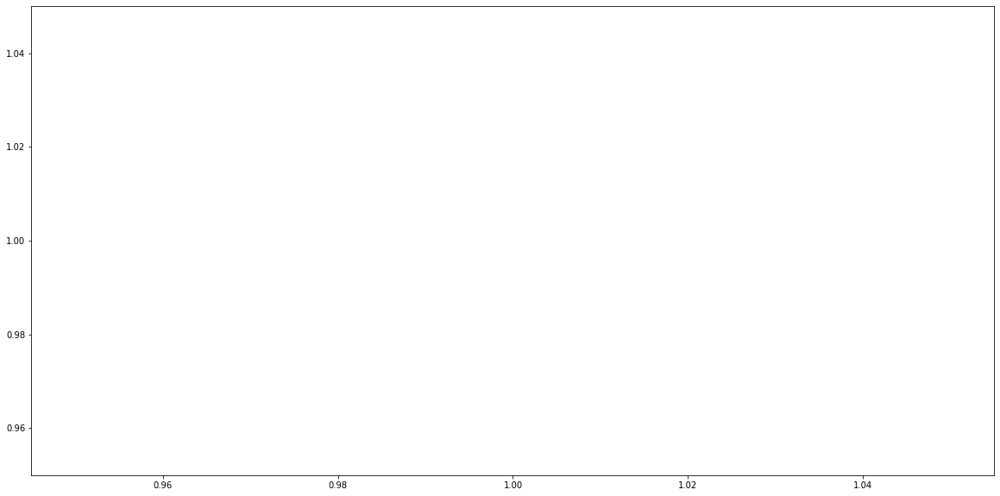

In [65]:
plt.figure(figsize=(20, 10))
plt.hist(np.transpose(tmp_cos_sims[0]))
plt.ylim(0.95,1.05)
#plt.xlim(0.75,1.0)

In [72]:
%matplotlib qt5
plt.figure(figsize=(20, 10))
plt.plot(tmp_cos_sims[1])
plt.plot(tmp_cos_sims[2])
plt.plot(tmp_cos_sims[3])
plt.plot(tmp_cos_sims[4])

In [81]:
round(tmp_cos_sims[1][0], 10)
# plt.hist(np.transpose(tmp_cos_sims[1].f5))

1.0

In [ ]:
ref = median_points

# calculate cosine simmlarities of each point comparing reference(new_yval) 
total_sims = []
for new_yval in new_yvals:
    new_yval = np.concatenate(new_yval).tolist()
    point_sims = []
    for i in range(len(reference)):
        # print(reference[i], new_yval[i])
        point_sim = distance.cosine(reference[i], new_yval[i])
        point_sims.append(point_sim)
    total_sims.append(point_sims)

In [ ]:
# consine similarity 
from sklearn.metrics.pairwise import cosine_similarity,cosine_distances
A=np.array([10,3])
B=np.array([8,7])
result=cosine_similarity(A.reshape(1,-1),B.reshape(1,-1))
print(result)

# # 
# import torch
# import torch.nn.functional as F
# a = torch.FloatTensor(t1)
# b = torch.FloatTensor(t2)
# result = F.cosine_similarity(a, b, dim=0)

In [98]:
A=np.array([10,3])

In [103]:
from sklearn.metrics.pairwise import cosine_similarity,cosine_distances
cosine_similarity(np.array(ref).reshape(1,-1), np.array(tmp).reshape(1,-1))

array([[0.99970682]])

In [104]:
# calculate cosine simmlarities of each point comparing reference(new_yval) 
cos_sims = []
for new_yval in new_yvals:
    cos_sim = cosine_similarity(np.array(ref).reshape(1,-1), np.array(new_yval).reshape(1,-1))
    cos_sims.append(cos_sim)

In [105]:
cos_sims

[array([[0.99978689]]),
 array([[0.99972555]]),
 array([[0.99992468]]),
 array([[0.99979065]]),
 array([[0.99990746]]),
 array([[0.99984261]]),
 array([[0.99949766]]),
 array([[0.99961355]]),
 array([[0.99989696]]),
 array([[0.99972593]]),
 array([[0.99974725]]),
 array([[0.99974428]]),
 array([[0.99980974]]),
 array([[0.99990226]]),
 array([[0.99995941]]),
 array([[0.99969567]]),
 array([[0.99988884]]),
 array([[0.99986563]]),
 array([[0.9996374]]),
 array([[0.99986612]]),
 array([[0.99995493]]),
 array([[0.99995929]]),
 array([[0.99979643]]),
 array([[0.99994759]]),
 array([[0.99933489]]),
 array([[0.99979297]]),
 array([[0.99993548]]),
 array([[0.99980783]]),
 array([[0.99994624]]),
 array([[0.99983781]]),
 array([[0.99986041]]),
 array([[0.99965693]]),
 array([[0.99992034]]),
 array([[0.99994698]]),
 array([[0.99990551]]),
 array([[0.99994595]]),
 array([[0.9998744]]),
 array([[0.99978515]]),
 array([[0.99994671]]),
 array([[0.99992649]]),
 array([[0.99991783]]),
 array([[0.9996886

In [108]:
plt.plot(np.concatenate(cos_sims))

In [110]:
cut_offs_95 = []
indexs = []
for i, cos_sim in enumerate(cos_sims):
    if cos_sim > 0.995:
        indexs.append(i)
        cut_offs_95.append(cos_sim)
        
    

In [120]:
cut_off = np.concatenate(np.concatenate(cut_offs_95)).tolist()

In [121]:
pd.DataFrame({'index': indexs, 'cos_sim': cut_off})

,index,cos_sim
0,0,0.999787
1,1,0.999726
2,2,0.999925
3,3,0.999791
4,4,0.999907
...,...,...
2263,2266,0.999502
2264,2267,0.999891
2265,2268,0.999848
2266,2269,0.999866


In [141]:
cut_off_90 = []
indexs = []
print(len(cos_sims))
for i, cos_sim in enumerate(cos_sims):
    if cos_sim > 0.990:
        indexs.append(i)
        print((np.concatenate(cos_sim)).tolist()[0])
        cut_off_90.append((np.concatenate(cos_sim)).tolist()[0])
#         cut_off_90.append((np.concatenate(cos_sim).tolist()))
        
    

2271
0.9997868887365773
0.9997255525995864
0.9999246769600681
0.9997906471174318
0.9999074638761092
0.9998426114337019
0.9994976570055947
0.9996135505951627
0.9998969555504842
0.999725932578678
0.9997472468765779
0.9997442780635941
0.9998097401304278
0.9999022636297096
0.99995941391296
0.9996956682966232
0.9998888418888757
0.9998656271332429
0.9996373984196643
0.9998661177173471
0.9999549294216473
0.9999592881420408
0.9997964291812449
0.9999475915699811
0.9993348940013845
0.9997929694117427
0.9999354839951446
0.9998078254597202
0.9999462401006691
0.9998378129089679
0.9998604088718543
0.9996569341558792
0.999920340093304
0.9999469823888564
0.9999055120340106
0.9999459478270433
0.9998744027943125
0.9997851483118751
0.9999467064802035
0.999926491641073
0.9999178277270008
0.999688617755126
0.9999696527063537
0.9997956783656534
0.9997194892324709
0.999909966797633
0.9998950026023465
0.9999170396398658
0.9996187021504379
0.99981184677846
0.9999204767094185
0.9999440702424087
0.99988347217993

In [144]:
pd.DataFrame({'index': indexs, 'cos_sim': cut_off_90})

,index,cos_sim
0,0,0.999787
1,1,0.999726
2,2,0.999925
3,3,0.999791
4,4,0.999907
...,...,...
2265,2266,0.999502
2266,2267,0.999891
2267,2268,0.999848
2268,2269,0.999866


In [148]:
cut_off_99 = []
indexs = []
print(len(cos_sims))
for i, cos_sim in enumerate(cos_sims):
    if cos_sim > 0.999:
        indexs.append(i)
#         print((np.concatenate(cos_sim)).tolist()[0])
        cut_off_99.append((np.concatenate(cos_sim)).tolist()[0])

pd.DataFrame({'index': indexs, 'cos_sim': cut_off_99})

2271


,index,cos_sim
0,0,0.999787
1,1,0.999726
2,2,0.999925
3,3,0.999791
4,4,0.999907
...,...,...
2206,2266,0.999502
2207,2267,0.999891
2208,2268,0.999848
2209,2269,0.999866


In [151]:
len(cut_off)/2271, len(cut_off_90)/2271, len(cut_off_99)/2271

(0.9986789960369881, 0.9995596653456627, 0.9735799207397622)

In [152]:
cut_off_995 = []
indexs = []
print(len(cos_sims))
for i, cos_sim in enumerate(cos_sims):
    if cos_sim > 0.9995:
        indexs.append(i)
#         print((np.concatenate(cos_sim)).tolist()[0])
        cut_off_995.append((np.concatenate(cos_sim)).tolist()[0])

pd.DataFrame({'index': indexs, 'cos_sim': cut_off_995})

2271


,index,cos_sim
0,0,0.999787
1,1,0.999726
2,2,0.999925
3,3,0.999791
4,4,0.999907
...,...,...
2053,2266,0.999502
2054,2267,0.999891
2055,2268,0.999848
2056,2269,0.999866


In [160]:
0.95 * 2271

2157.45

In [181]:
a = pd.DataFrame({'index':range(len(cos_sims)), 'cos_sim':np.concatenate(np.concatenate(cos_sims)).tolist()})#,ascending=False)

In [189]:
#a.sort_values(by[])
tmp = a.sort_values(by=['cos_sim'], ascending=False)
tmp_index= tmp['index']
re_sort_a = pd.DataFrame({'index':tmp['index'], 'cos_sim': tmp['cos_sim']}, index)
#a.sort_values(by='cos_sim', key=lambda col: col.)
# from natsort import index_natsorted
# df.sort_values(
#    by="time",
#    key=lambda x: np.argsort(index_natsorted(df["time"]))

In [215]:
tmp_index = tmp['index']

In [219]:
tmp.index= list(range(len(cos_sims)))

In [220]:
tmp

,index,cos_sim
0,302,0.999983
1,1030,0.999980
2,1537,0.999975
3,361,0.999975
4,81,0.999975
...,...,...
2266,454,0.996762
2267,440,0.995555
2268,1976,0.994916
2269,1905,0.994246


In [195]:
re_sort_a.index= list(range(len(cos_sims)))

In [218]:
re_sort_a#.index= list(range(len(cos_sims)))

,index,cos_sim
0,302,0.999983
1,1030,0.999980
2,1537,0.999975
3,361,0.999975
4,81,0.999975
...,...,...
2266,454,0.996762
2267,440,0.995555
2268,1976,0.994916
2269,1905,0.994246


In [216]:
tmp_index

302      302
1030    1030
1537    1537
361      361
81        81
        ... 
454      454
440      440
1976    1976
1905    1905
1906    1906
Name: index, Length: 2271, dtype: int64

In [211]:
re_sort_a

,index,cos_sim
0,302,0.999983
1,1030,0.999980
2,1537,0.999975
3,361,0.999975
4,81,0.999975
...,...,...
2266,454,0.996762
2267,440,0.995555
2268,1976,0.994916
2269,1905,0.994246


In [206]:
valid_rr = re_sort_a.loc[:2156]#[:]
valid_rr
#valid_rr = re_sort_a.loc[:2157]['index']

,index,cos_sim
0,302,0.999983
1,1030,0.999980
2,1537,0.999975
3,361,0.999975
4,81,0.999975
...,...,...
2152,1219,0.999282
2153,1938,0.999282
2154,995,0.999281
2155,515,0.999279


#### 2021-09-27 Finished #####

### 2021-09-27 cut off test

##### ========== test start ==========

In [ ]:
cut_off_sig_95 = []
indexs = []

print(len(cos_sims))
for i, cos_sim in enumerate(cos_sims):
    
    if cos_sim > 0.9995:
        indexs.append(i)
#         print((np.concatenate(cos_sim)).tolist()[0])
        cut_off_sig_95.append((np.concatenate(cos_sim)).tolist()[0])

pd.DataFrame({'index': indexs, 'cos_sim': cut_off_995})

In [153]:
len(cut_off)/2271, len(cut_off_90)/2271, len(cut_off_99)/2271, len(cut_off_995)/2271

(0.9986789960369881,
 0.9995596653456627,
 0.9735799207397622,
 0.9062087186261559)

In [155]:
plt.hist(cut_off_995)

(array([ 34.,  52.,  57.,  78., 118., 178., 266., 436., 543., 296.]),
 array([0.99950165, 0.99954983, 0.999598  , 0.99964618, 0.99969436,
        0.99974253, 0.99979071, 0.99983888, 0.99988706, 0.99993524,
        0.99998341]),
 <BarContainer object of 10 artists>)

In [158]:
plt.hist(cut_off_995)

(array([ 34.,  52.,  57.,  78., 118., 178., 266., 436., 543., 296.]),
 array([0.99950165, 0.99954983, 0.999598  , 0.99964618, 0.99969436,
        0.99974253, 0.99979071, 0.99983888, 0.99988706, 0.99993524,
        0.99998341]),
 <BarContainer object of 10 artists>)

In [159]:
plt.hist(cut_off_99)

(array([ 13.,  19.,  34.,  39.,  41.,  84., 134., 296., 696., 855.]),
 array([0.99900431, 0.99910222, 0.99920013, 0.99929804, 0.99939595,
        0.99949386, 0.99959177, 0.99968968, 0.99978759, 0.9998855 ,
        0.99998341]),
 <BarContainer object of 10 artists>)

##### ========== test Finishd ==========

#### ========== trash ==========

In [ ]:
total_points = []
for i in range(len(new_yvals)):
    points = []
    for j in range(len(new_yvals[0])):    
        print('processing >>> {}, {}'.format(i, j))
        point = new_yvals[i][j]
        points.append(point)
    total_points.append(points)

processing >>> 0, 0
processing >>> 0, 1
processing >>> 0, 2
processing >>> 0, 3
processing >>> 0, 4
processing >>> 0, 5
processing >>> 0, 6
processing >>> 0, 7
processing >>> 0, 8
processing >>> 0, 9
processing >>> 0, 10
processing >>> 0, 11
processing >>> 0, 12
processing >>> 0, 13
processing >>> 0, 14
processing >>> 0, 15
processing >>> 0, 16
processing >>> 0, 17
processing >>> 0, 18
processing >>> 0, 19
processing >>> 0, 20
processing >>> 0, 21
processing >>> 0, 22
processing >>> 0, 23
processing >>> 0, 24
processing >>> 0, 25
processing >>> 0, 26
processing >>> 0, 27
processing >>> 0, 28
processing >>> 0, 29
processing >>> 0, 30
processing >>> 0, 31
processing >>> 0, 32
processing >>> 0, 33
processing >>> 0, 34
processing >>> 0, 35
processing >>> 0, 36
processing >>> 0, 37
processing >>> 0, 38
processing >>> 0, 39
processing >>> 0, 40
processing >>> 0, 41
processing >>> 0, 42
processing >>> 0, 43
processing >>> 0, 44
processing >>> 0, 45
processing >>> 0, 46
processing >>> 0, 47
pr

In [ ]:
cut_off_98 = []
indexs = []
print(len(cos_sims))
for i, cos_sim in enumerate(cos_sims):
    if cos_sim > 0.980:
        indexs.append(i)
#         print((np.concatenate(cos_sim)).tolist()[0])
        cut_off_98.append((np.concatenate(cos_sim)).tolist()[0])

    

In [168]:
len(points[2])

1

In [164]:
for i in range(len(new_yvals)):
    if len(new_yvals[i]) != 287:
           print(i)

In [163]:
len(new_yvals)

2271

In [88]:
# label rr_invervals as rrid_1, rrid_2 .. rrid_n
rrids = ["rrid_" + str(i) for i in range(len(rr_intervals))]

# create a dictionary
rr_dict = dict(zip(rrids, new_yvals))

# get all the book ids in a list
ids = list(rr_dict.keys())

# create all possible pairs
base_rr = []
target_rr = []
pairs = []
# create a list of tuples
for i, v in enumerate(ids):
    for j in ids[i+1:]:
        base_rr.append(ids[i])
        target_rr.append(j)
        pairs.append((ids[i], j))        

In [89]:
# create a dataframe
base_ids = []
target_ids = []
final_similarities = []

# calculate base, target, similarity using Resampling data: new_yvals
for i in range(len(new_yvals)):
    if i+1 < len(new_yvals):
        base_ids.append(ids[i])
        target_ids.append(ids[i+1])
        final_similarity = 1- distance.cosine(new_yvals[i], new_yvals[i+1])
        final_similarities.append(final_similarity)

In [90]:
print("There are a total of " + str(len(pairs)) + " pairs")
print("Displaying first 10 pairs: ")
display(pairs[:10])
print("....")
print("Displaying last 10 pairs: ")
display(pairs[-10:])

There are a total of 2577585 pairs
Displaying first 10 pairs: 


[('rrid_0', 'rrid_1'),
 ('rrid_0', 'rrid_2'),
 ('rrid_0', 'rrid_3'),
 ('rrid_0', 'rrid_4'),
 ('rrid_0', 'rrid_5'),
 ('rrid_0', 'rrid_6'),
 ('rrid_0', 'rrid_7'),
 ('rrid_0', 'rrid_8'),
 ('rrid_0', 'rrid_9'),
 ('rrid_0', 'rrid_10')]

....
Displaying last 10 pairs: 


[('rrid_2266', 'rrid_2267'),
 ('rrid_2266', 'rrid_2268'),
 ('rrid_2266', 'rrid_2269'),
 ('rrid_2266', 'rrid_2270'),
 ('rrid_2267', 'rrid_2268'),
 ('rrid_2267', 'rrid_2269'),
 ('rrid_2267', 'rrid_2270'),
 ('rrid_2268', 'rrid_2269'),
 ('rrid_2268', 'rrid_2270'),
 ('rrid_2269', 'rrid_2270')]

### Make DataFrame for each pair and cosine similarity

In [144]:
# create a dataframe
base_ids = []
target_ids = []
final_similarities = []


# calculate base, target, similarity using Resampling data: new_yvals
for i in range(len(new_yvals)):
    if i+1 < len(new_yvals):
        base_ids.append(ids[i])
        target_ids.append(ids[i+1])
        final_similarity = distance.cosine(new_yvals[i], new_yvals[i+1])
        final_similarities.append(final_similarity)

In [145]:
len(base_ids), len(target_ids), len(final_similarities)

(2270, 2270, 2270)

In [146]:
#np.where(max(final_similarities))
final_similarities.index(min(final_similarities)) #1006

1006

In [125]:
# 예시
pd.DataFrame({'1006': np.concatenate(new_yvals[1006]).tolist() , '2000': np.concatenate(new_yvals[2000]).tolist()}, columns=['1006','2000'])

,1006,2000
0,0.840834,0.819620
1,0.810276,0.798045
2,0.734761,0.744234
3,0.631302,0.671979
4,0.523335,0.586222
...,...,...
282,0.499656,0.592251
283,0.578816,0.649725
284,0.668401,0.710158
285,0.752961,0.758910


In [152]:
reference = np.concatenate(new_yvals[1006]).tolist()


# calculate cosine simmlarities of each point comparing reference(new_yval) 
total_sims = []
for new_yval in new_yvals:
    new_yval = np.concatenate(new_yval).tolist()
    point_sims = []
    for i in range(len(reference)):
        # print(reference[i], new_yval[i])
        point_sim = distance.cosine(reference[i], new_yval[i])
        point_sims.append(point_sim)
    total_sims.append(point_sims)
   

In [153]:
total_sims[0:1]

[[0.0,
  2.220446049250313e-16,
  1.1102230246251565e-16,
  0.0,
  0.0,
  0.0,
  2.220446049250313e-16,
  0.0,
  0.0,
  0.0,
  0.0,
  1.1102230246251565e-16,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  1.1102230246251565e-16,
  2.220446049250313e-16,
  0.0,
  0.0,
  0.0,
  1.1102230246251565e-16,
  0.0,
  0.0,
  0.0,
  1.1102230246251565e-16,
  0.0,
  2.220446049250313e-16,
  1.1102230246251565e-16,
  0.0,
  0.0,
  0.0,
  0.0,
  2.220446049250313e-16,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  1.1102230246251565e-16,
  2.220446049250313e-16,
  0.0,
  2.220446049250313e-16,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  2.220446049250313e-16,
  1.1102230246251565e-16,
  0.0,
  0.0,
  0.0,
  0.0,
  2.220446049250313e-16,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  2.220446049250313e-16,
  0.0,
  1.1102230246251565e-16,
  0.0,
  1.1102230246251565e-16,
  0.0,
  0.0,
  0.0,
  0.0,
  2.220446049250313e-16,
  0.0,
  0

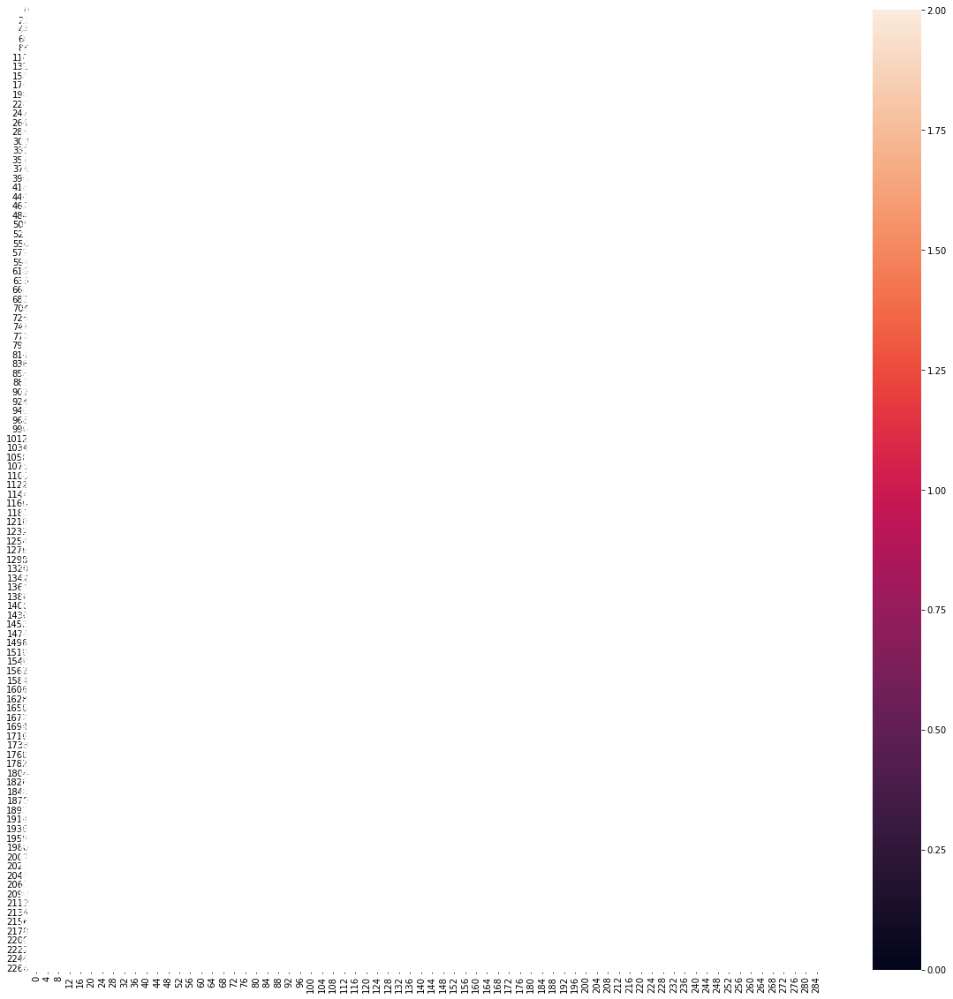

In [157]:
import seaborn as sns
f, ax = plt.subplots(figsize=(20, 20))
ax = sns.heatmap(total_sims, annot=True)#, fmt="d")

In [ ]:
rr_pivot = df_update.pivot('target_rr', 'base_rr', '1-cosine_similarity')
f, ax = plt.subplots(figsize=(20, 20))
ax = sns.heatmap(rr_pivot)#, linewidths=.5)#, annot=True, fmt="d")

(0    1.088302
 dtype: float64,
 0   -0.312092
 dtype: float64)

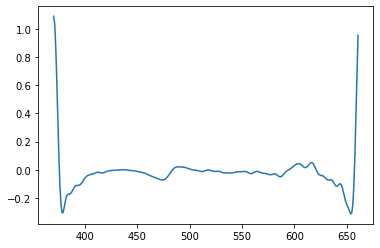

In [9]:
plt.plot(fxvals[370:662])

np.max(fxvals[370:662]), np.min(fxvals[370:662])

(0.7849316273137059, 0.36691101761915085)

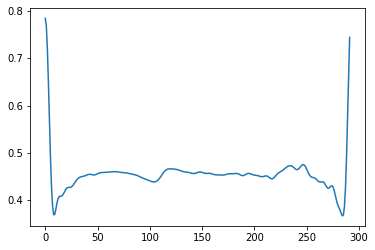

In [10]:
plt.plot(fxvals_MinMax[370:662])

np.max(fxvals_MinMax[370:662]), np.min(fxvals_MinMax[370:662])

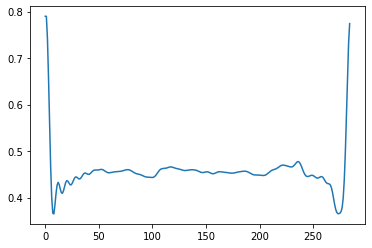

In [11]:
plt.plot(fxvals_MinMax[662:947])

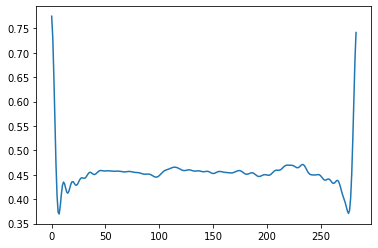

In [12]:
plt.plot(fxvals_MinMax[947:1231])

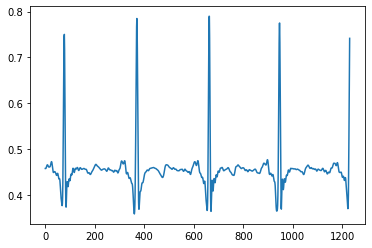

In [13]:
plt.plot(fxvals_MinMax[:1231])

In [ ]:
# reference r-r interval 

# rpeak = 1 
# 1) abnormal/ normal -> median (overall mean)
# 1-1) t-wave; r-peak 보다 큰 경우
# 2) qrs width 
# p-qrs-t wave annotation 
# normalization 1) amplitudue, time(cycle)



In [34]:
rpeaks[0]

0           77.0
1          370.0
2          662.0
3          947.0
4         1231.0
          ...   
2267    648733.0
2268    648978.0
2269    649232.0
2270    649484.0
2271    649733.0
Name: 0, Length: 2272, dtype: float64

In [39]:
rpeaks.iloc[1]

0    370.0
Name: 1, dtype: float64

In [44]:
rr_interval = rpeaks.iloc[4] - rpeaks.iloc[3]

In [47]:
rpeaks.iloc[4] - rpeaks.iloc[3], rpeaks.iloc[6] - rpeaks.iloc[5]

(0    284.0
 dtype: float64,
 0    294.0
 dtype: float64)

In [49]:
rr_intervals = []
for i in range(len(rpeaks)):
    if i + 1 == len(rpeaks):
        break
    else:
        rr_interval = rpeaks.iloc[i+1] - rpeaks.iloc[i]
        rr_intervals.append(int(rr_interval))

(array([1.000e+01, 1.800e+01, 3.100e+01, 3.790e+02, 1.452e+03, 3.510e+02,
        1.300e+01, 1.600e+01, 0.000e+00, 1.000e+00]),
 array([179. , 203.2, 227.4, 251.6, 275.8, 300. , 324.2, 348.4, 372.6,
        396.8, 421. ]),
 <BarContainer object of 10 artists>)

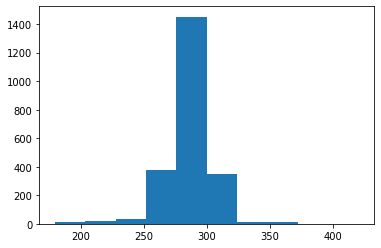

In [59]:
plt.hist(rr_intervals)# np.mean(rr_intervals), np.median(rr_intervals), np.max(rr_intervals)


In [65]:
pd.DataFrame(rr_intervals).describe()

,0
count,2271.000000
mean,286.066050
std,17.663149
min,179.000000
25%,278.000000
50%,287.000000
75%,296.000000
max,421.000000


In [67]:
np.median(rr_intervals)

287.0

In [ ]:
# 1:287
rr_ref = np.median(rr_intervals)

for i in rr_intervals:
    if i == np.median(rr_intervals):
        pass
    elif i != np.median(rr_intervals):
        i/np.median(rr_intervals)
        

In [70]:
rpeaks.iloc[50]

0    14710.0
Name: 50, dtype: float64

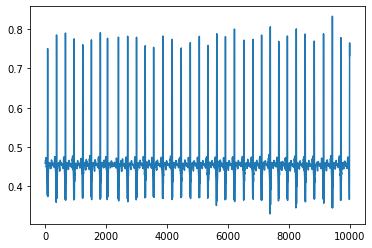

In [74]:
plt.plot(fxvals_MinMax[:10000])

In [14]:
#rr_intervals
#rpeaks.iloc[4]
#fxvals_MinMax[947:1231]

rr_intervals = []
y_vals = []
for i in range(len(rpeaks)):
    if i + 1 == len(rpeaks):
        break
    else:
        rr_interval = rpeaks.iloc[i+1] - rpeaks.iloc[i]
        y_val = fxvals_MinMax[int(rpeaks.iloc[i]):int(rpeaks.iloc[i+1])]
        rr_intervals.append(int(rr_interval))
        y_vals.append(y_val)
        

In [15]:
len(y_vals), len(rr_intervals)

(2271, 2271)

In [20]:
# resampling

from scipy import signal
x =  list(range(rr_intervals[0]))
y = y_vals[0]
f = signal.resample(y, 286)

In [21]:
f = signal.resample(y_vals[0], 286)
len(f), len(y_vals[0])

(286, 293)

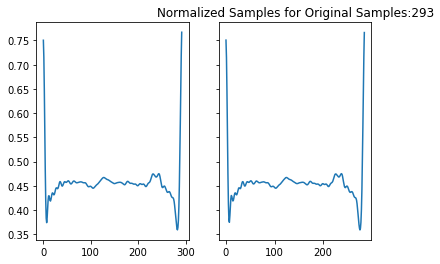

In [22]:
fig, (ax1, ax2) = plt.subplots(1, 2, sharey=True)
plt.title('Normalized Samples for Original Samples:{}'.format(len(y_vals[0])))
ax1.plot(y_vals[0])
#ax1.('Samples:{}')#.format(rr_intervals[0]))
# ax1.grid()
ax2.plot(f)

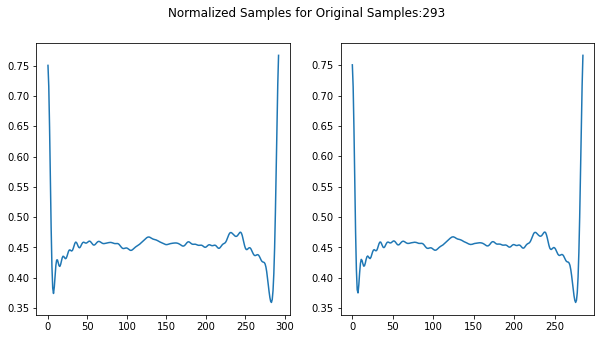

In [23]:
import numpy as np
import matplotlib.pyplot as plt


plt.figure(figsize=(10, 5))
plt.suptitle('Normalized Samples for Original Samples:{}'.format(len(y_vals[0])))

plt.subplot(121)
plt.plot(y_vals[0])
 
plt.subplot(122)
plt.plot(f)
plt.show()

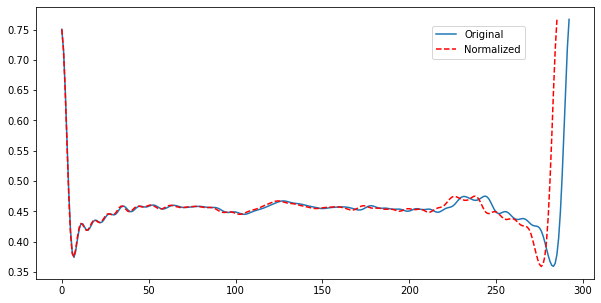

In [24]:
plt.figure(figsize=(10, 5))
plt.plot(y_vals[0], label='Original')
plt.plot(f, 'r--', label='Normalized')
plt.legend(loc='upper left', bbox_to_anchor=(0.7, 0.95))

## resampling based on RR-intervals' mean 

In [30]:
# Split samples based on rr_intervals 
rr_intervals = []
y_vals = []
for i in range(len(rpeaks)):
    if i + 1 == len(rpeaks):
        break
    else:
        rr_interval = rpeaks.iloc[i+1] - rpeaks.iloc[i]
        y_val = fxvals_MinMax[int(rpeaks.iloc[i]):int(rpeaks.iloc[i+1])]
        rr_intervals.append(int(rr_interval))
        y_vals.append(y_val)

# resampling
from scipy import signal
new_yvals = []
norm_sample= int(np.mean(rr_intervals))
for i in range(len(y_vals)):
    new_yval = signal.resample(y_vals[i], norm_sample)
    new_yvals.append(new_yval)

In [26]:
# label rr_invervals as rrid_1, rrid_2 .. rrid_n
rrids = ["rrid_" + str(i) for i in range(len(rr_intervals))]

In [27]:
# create a dictionary
rr_dict = dict(zip(rrids, new_yvals))

In [28]:
# get all the book ids in a list
ids = list(rr_dict.keys())

In [29]:
# create all possible pairs
pairs = []
# create a list of tuples
for i, v in enumerate(ids):
    for j in ids[i+1:]:
        pairs.append((ids[i], j))

In [31]:
print("There are a total of " + str(len(pairs)) + " pairs")
print("Displaying first 10 pairs: ")
display(pairs[:10])
print("....")
print("Displaying last 10 pairs: ")
display(pairs[-10:])

There are a total of 2577585 pairs
Displaying first 10 pairs: 


[('rrid_0', 'rrid_1'),
 ('rrid_0', 'rrid_2'),
 ('rrid_0', 'rrid_3'),
 ('rrid_0', 'rrid_4'),
 ('rrid_0', 'rrid_5'),
 ('rrid_0', 'rrid_6'),
 ('rrid_0', 'rrid_7'),
 ('rrid_0', 'rrid_8'),
 ('rrid_0', 'rrid_9'),
 ('rrid_0', 'rrid_10')]

....
Displaying last 10 pairs: 


[('rrid_2266', 'rrid_2267'),
 ('rrid_2266', 'rrid_2268'),
 ('rrid_2266', 'rrid_2269'),
 ('rrid_2266', 'rrid_2270'),
 ('rrid_2267', 'rrid_2268'),
 ('rrid_2267', 'rrid_2269'),
 ('rrid_2267', 'rrid_2270'),
 ('rrid_2268', 'rrid_2269'),
 ('rrid_2268', 'rrid_2270'),
 ('rrid_2269', 'rrid_2270')]

In [32]:
pairwise_cosine_similarity = [distance.cosine(rr_dict[pair[0]], rr_dict[pair[1]]) for pair in pairs]

In [33]:
len(pairwise_cosine_similarity)

2577585

### Make DataFrame for each pair and cosine similarity 

In [ ]:
pd.DataFrame({'base_rr': })

In [ ]:
# create all possible pairs
pairs = []
# create a list of tuples
for i, v in enumerate(ids):
    for j in ids[i+1:]:
        print(j)
        break
#         base_rr.append(ids[i])
#         base_rr.((ids[i+1:], j))

In [111]:
# create all possible pairs
base_rr = []
target_rr = []
pairs = []

# create a list of tuples
for i, v in enumerate(ids):
    for j in ids[i+1:]:
        base_rr.append(ids[i])
        target_rr.append(j)
        pairs.append((ids[i], j))
#        (pairs = base_rr, target_rr)


In [112]:
len(base_rr), len(target_rr), len(pairs), len(pairwise_cosine_similarity)

(2577585, 2577585, 2577585, 2577585)

In [114]:
# create a dataframe
df = pd.DataFrame({'pair':pairs, 'base_rr': base_rr, 'target_rr': target_rr, 'similarity': pairwise_cosine_similarity})
display(df.head())
display(df.tail())

,pair,base_rr,target_rr,similarity
0,"(rrid_0, rrid_1)",rrid_0,rrid_1,0.000593
1,"(rrid_0, rrid_2)",rrid_0,rrid_2,0.000388
2,"(rrid_0, rrid_3)",rrid_0,rrid_3,0.000171
3,"(rrid_0, rrid_4)",rrid_0,rrid_4,0.000099
4,"(rrid_0, rrid_5)",rrid_0,rrid_5,0.000116


,pair,base_rr,target_rr,similarity
2577580,"(rrid_2267, rrid_2269)",rrid_2267,rrid_2269,0.000109
2577581,"(rrid_2267, rrid_2270)",rrid_2267,rrid_2270,0.000225
2577582,"(rrid_2268, rrid_2269)",rrid_2268,rrid_2269,0.000113
2577583,"(rrid_2268, rrid_2270)",rrid_2268,rrid_2270,0.000396
2577584,"(rrid_2269, rrid_2270)",rrid_2269,rrid_2270,0.000360


In [115]:
final_similarity = [1-distance.cosine(rr_dict[pair[0]], rr_dict[pair[1]]) for pair in pairs]

In [116]:
df_update = pd.DataFrame({'pair':pairs, 'base_rr': base_rr, 'target_rr': target_rr, 'similarity': pairwise_cosine_similarity, '1-cosine_similarity': final_similarity})
display(df_update.head())
display(df_update.tail())

,pair,base_rr,target_rr,similarity,1-cosine_similarity
0,"(rrid_0, rrid_1)",rrid_0,rrid_1,0.000593,0.999407
1,"(rrid_0, rrid_2)",rrid_0,rrid_2,0.000388,0.999612
2,"(rrid_0, rrid_3)",rrid_0,rrid_3,0.000171,0.999829
3,"(rrid_0, rrid_4)",rrid_0,rrid_4,0.000099,0.999901
4,"(rrid_0, rrid_5)",rrid_0,rrid_5,0.000116,0.999884


,pair,base_rr,target_rr,similarity,1-cosine_similarity
2577580,"(rrid_2267, rrid_2269)",rrid_2267,rrid_2269,0.000109,0.999891
2577581,"(rrid_2267, rrid_2270)",rrid_2267,rrid_2270,0.000225,0.999775
2577582,"(rrid_2268, rrid_2269)",rrid_2268,rrid_2269,0.000113,0.999887
2577583,"(rrid_2268, rrid_2270)",rrid_2268,rrid_2270,0.000396,0.999604
2577584,"(rrid_2269, rrid_2270)",rrid_2269,rrid_2270,0.000360,0.999640


In [117]:
rr_pivot = pivot(df_update['target_rr'], df_update['base_rr'], df_update['similarity'])
ax = sns.heatmap(rr_pivot, annot=True, fmt="d")

NameError: name 'pivot' is not defined

In [123]:
essen = df_update.pop('pair')
essen = df_update.pop('similarity')

In [125]:
df_update

,base_rr,target_rr,1-cosine_similarity
0,rrid_0,rrid_1,0.999407
1,rrid_0,rrid_2,0.999612
2,rrid_0,rrid_3,0.999829
3,rrid_0,rrid_4,0.999901
4,rrid_0,rrid_5,0.999884
...,...,...,...
2577580,rrid_2267,rrid_2269,0.999891
2577581,rrid_2267,rrid_2270,0.999775
2577582,rrid_2268,rrid_2269,0.999887
2577583,rrid_2268,rrid_2270,0.999604


In [ ]:
rr_pivot = pivot(df_update['target_rr'], df_update['base_rr'], df_update['similarity'])
ax = sns.heatmap(rr_pivot, annot=True, fmt="d")

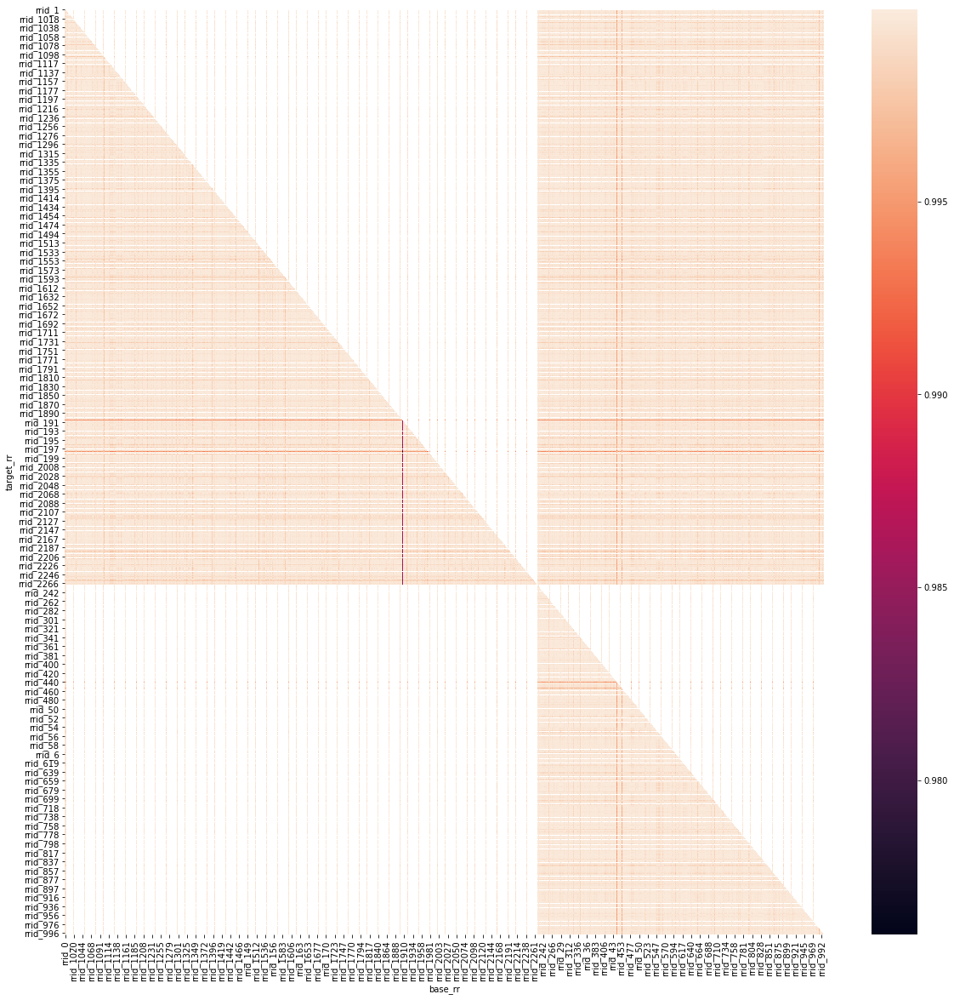

In [134]:
rr_pivot = df_update.pivot('target_rr', 'base_rr', '1-cosine_similarity')
f, ax = plt.subplots(figsize=(20, 20))
ax = sns.heatmap(rr_pivot)#, linewidths=.5)#, annot=True, fmt="d")

In [ ]:
ax = sns.heatmap()

In [136]:
df_update.pivot('target_rr', 'base_rr', '1-cosine_similarity')

base_rr,rrid_0,rrid_1,rrid_10,rrid_100,rrid_1000,rrid_1001,rrid_1002,rrid_1003,rrid_1004,rrid_1005,...,rrid_990,rrid_991,rrid_992,rrid_993,rrid_994,rrid_995,rrid_996,rrid_997,rrid_998,rrid_999
target_rr,,,,,,,,,,,,,,,,,,,,,
rrid_1,0.999407,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
rrid_10,0.999472,0.999910,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
rrid_100,0.999906,0.999365,0.999399,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
rrid_1000,0.999703,0.999413,0.999383,0.999813,NaN,NaN,NaN,NaN,NaN,NaN,...,0.999613,0.999926,0.999945,0.999865,0.999909,0.999384,0.999848,0.999824,0.999767,0.999787
rrid_1001,0.999516,0.999038,0.999015,0.999738,0.999901,NaN,NaN,NaN,NaN,NaN,...,0.999297,0.999782,0.999890,0.999735,0.999833,0.999519,0.999749,0.999841,0.999571,0.999578
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
rrid_995,0.999328,0.998521,0.998567,0.999488,NaN,NaN,NaN,NaN,NaN,NaN,...,0.998760,0.999265,0.999235,0.999184,0.999455,NaN,NaN,NaN,NaN,NaN
rrid_996,0.999457,0.999634,0.999530,0.999636,NaN,NaN,NaN,NaN,NaN,NaN,...,0.999695,0.999884,0.999867,0.999756,0.999769,0.999110,NaN,NaN,NaN,NaN
rrid_997,0.999299,0.999252,0.999217,0.999557,NaN,NaN,NaN,NaN,NaN,NaN,...,0.999422,0.999800,0.999853,0.999667,0.999800,0.999276,0.999836,NaN,NaN,NaN


In [151]:
df_pivot = df_update.pivot('target_rr', 'base_rr', '1-cosine_similarity')

In [153]:
df_pivot.head()

base_rr,rrid_0,rrid_1,rrid_10,rrid_100,rrid_1000,rrid_1001,rrid_1002,rrid_1003,rrid_1004,rrid_1005,...,rrid_990,rrid_991,rrid_992,rrid_993,rrid_994,rrid_995,rrid_996,rrid_997,rrid_998,rrid_999
target_rr,,,,,,,,,,,,,,,,,,,,,
rrid_1,0.999407,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
rrid_10,0.999472,0.999910,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
rrid_100,0.999906,0.999365,0.999399,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
rrid_1000,0.999703,0.999413,0.999383,0.999813,NaN,NaN,NaN,NaN,NaN,NaN,...,0.999613,0.999926,0.999945,0.999865,0.999909,0.999384,0.999848,0.999824,0.999767,0.999787
rrid_1001,0.999516,0.999038,0.999015,0.999738,0.999901,NaN,NaN,NaN,NaN,NaN,...,0.999297,0.999782,0.999890,0.999735,0.999833,0.999519,0.999749,0.999841,0.999571,0.999578


In [147]:
col = df_update['base_rr']
idx = df_update['target_rr']

In [150]:
df_update['1-cosine_similarity']

0          0.999407
1          0.999612
2          0.999829
3          0.999901
4          0.999884
             ...   
2577580    0.999891
2577581    0.999775
2577582    0.999887
2577583    0.999604
2577584    0.999640
Name: 1-cosine_similarity, Length: 2577585, dtype: float64

TypeError: '<=' not supported between instances of 'str' and 'float'

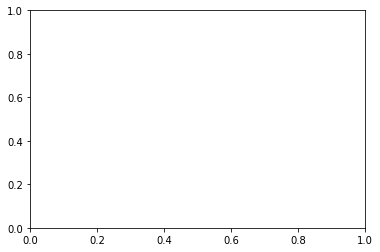

In [146]:
plt.pcolor(df_update)

In [135]:
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(7, 5))
    ax = sns.heatmap(corr, mask=mask, vmax=.3, square=True)


['rrid_1',
 'rrid_2',
 'rrid_3',
 'rrid_4',
 'rrid_5',
 'rrid_6',
 'rrid_7',
 'rrid_8',
 'rrid_9',
 'rrid_10',
 'rrid_11',
 'rrid_12',
 'rrid_13',
 'rrid_14',
 'rrid_15',
 'rrid_16',
 'rrid_17',
 'rrid_18',
 'rrid_19',
 'rrid_20',
 'rrid_21',
 'rrid_22',
 'rrid_23',
 'rrid_24',
 'rrid_25',
 'rrid_26',
 'rrid_27',
 'rrid_28',
 'rrid_29',
 'rrid_30',
 'rrid_31',
 'rrid_32',
 'rrid_33',
 'rrid_34',
 'rrid_35',
 'rrid_36',
 'rrid_37',
 'rrid_38',
 'rrid_39',
 'rrid_40',
 'rrid_41',
 'rrid_42',
 'rrid_43',
 'rrid_44',
 'rrid_45',
 'rrid_46',
 'rrid_47',
 'rrid_48',
 'rrid_49',
 'rrid_50',
 'rrid_51',
 'rrid_52',
 'rrid_53',
 'rrid_54',
 'rrid_55',
 'rrid_56',
 'rrid_57',
 'rrid_58',
 'rrid_59',
 'rrid_60',
 'rrid_61',
 'rrid_62',
 'rrid_63',
 'rrid_64',
 'rrid_65',
 'rrid_66',
 'rrid_67',
 'rrid_68',
 'rrid_69',
 'rrid_70',
 'rrid_71',
 'rrid_72',
 'rrid_73',
 'rrid_74',
 'rrid_75',
 'rrid_76',
 'rrid_77',
 'rrid_78',
 'rrid_79',
 'rrid_80',
 'rrid_81',
 'rrid_82',
 'rrid_83',
 'rrid_84',
 

In [37]:
import utils 

In [49]:
# initialize an empty dataframe grid
df_hm = pd.DataFrame({'ind': range(2271), 'cols': range(2271), 'vals': pd.Series(np.zeros(2271))})

# convert to a matrix
df_hm = df_hm.pivot(index='ind', columns='cols').fillna(0)

# make a copy
df_temp = df.copy()

# convert list of tuples into 2 lists
list1 = []
list2 = []
for item1, item2 in df_temp.pair:
    list1.append(item1)
    list2.append(item2)

# add two columns to df_temp
df_temp['rr1'] = list1
df_temp['rr2'] = list2

# drop the pair as it not needed
df_temp.drop('pair', axis=1, inplace=True)

# extract index so that you can construct pairs
df_temp['rr1'] = df_temp['rr1'].apply(lambda x: int(x.split('_')[-1]))
df_temp['rr2'] = df_temp['rr2'].apply(lambda x: int(x.split('_')[-1]))

# create tuples (0, 1, similarity)
df_temp['pairs'] = list(zip(df_temp.rr1, df_temp.rr2, df_temp.similarity))

# display(df_temp.head())

# to get lower diagnol, swap the rows and cols.
for row, col, similarity in df_temp.pairs:
    #print(row,col,similarity)
    df_hm.iloc[col, row] = similarity




AttributeError: module 'utils' has no attribute 'plot_heatmap'

In [61]:
df_hm.iloc[0]

      cols
vals  0       0.0
      1       0.0
      2       0.0
      3       0.0
      4       0.0
             ... 
      2266    0.0
      2267    0.0
      2268    0.0
      2269    0.0
      2270    0.0
Name: 0, Length: 2271, dtype: float64

In [58]:
import seaborn as sns

df_hm_sns = sns.load_dataset(df_hm)
df_hm_sns_map = df_hm_sns.pivot('cols', 'ind', 'similarity')
ax = sns.heatmap(df_hm_sns_map)

ValueError: The truth value of a DataFrame is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

In [56]:
from utils import plot_heatmap
ax = utils.plot_heatmap(df_hm, ids, ids)


ImportError: cannot import name 'plot_heatmap' from 'utils' (C:\Users\MI2RL-KHJ\anaconda3\envs\ecg_env\lib\site-packages\utils\__init__.py)

In [ ]:
import seaborn as sns


In [42]:
for row, col, similarity in df_temp.pairs:
    df_hm.iloc[col, row] = similarity 
    print(col, row, similarity)
    break

1 0 0.0


In [45]:
df_hm.iloc[2, 0] 

0.00038824279706517473

In [73]:
# Error
# # calculate cosine similarity

# similar_matrix = []
# for pair in pairs:
#     pairwise_cosine_similarity = distance.cosine(rr_dict[pair[0]], rr_dict[pair[1]])
#     similar_matrix.append(dict(zip(pair, pairwise_cosine_similarity)))

TypeError: 'numpy.float64' object is not iterable

In [25]:

# heatmap
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
import seaborn as sns

#similarity = cosine_similarity(new_yvals)
#print(similarity.shape)

for i in range(len(new_yvals)):
    for j in range(len(new_yvals):
        similarity = distance.cosine(new_yvals[i], new_yvals[j])
    

2271

2577585

,pair,similarity
0,"(rrid_0, rrid_1)",0.000593
1,"(rrid_0, rrid_2)",0.000388
2,"(rrid_0, rrid_3)",0.000171
3,"(rrid_0, rrid_4)",0.000099
4,"(rrid_0, rrid_5)",0.000116


,pair,similarity
2577580,"(rrid_2267, rrid_2269)",0.000109
2577581,"(rrid_2267, rrid_2270)",0.000225
2577582,"(rrid_2268, rrid_2269)",0.000113
2577583,"(rrid_2268, rrid_2270)",0.000396
2577584,"(rrid_2269, rrid_2270)",0.000360


ImportError: cannot import name 'plot_heatmap' from 'utils' (C:\Users\MI2RL-KHJ\anaconda3\envs\ecg_env\lib\site-packages\utils\__init__.py)

In [81]:
df_temp = df.copy()
df_temp.pair

0                (rrid_0, rrid_1)
1                (rrid_0, rrid_2)
2                (rrid_0, rrid_3)
3                (rrid_0, rrid_4)
4                (rrid_0, rrid_5)
                    ...          
2577580    (rrid_2267, rrid_2269)
2577581    (rrid_2267, rrid_2270)
2577582    (rrid_2268, rrid_2269)
2577583    (rrid_2268, rrid_2270)
2577584    (rrid_2269, rrid_2270)
Name: pair, Length: 2577585, dtype: object

In [ ]:
## Plot a heatmap of cosine similarity values

from utils import plot_heatmap
# initialize an empty dataframe grid
df_hm = pd.DataFrame({'ind': range(24), 'cols': range(24), 'vals': pd.Series(np.zeros(24))})